In [ ]:
  ## this connects to my google drive
  # from google.colab import drive
  # drive.mount('/content/drive')

In [ ]:
  ## to delete any existing directory
  # import shutil
  # shutil.rmtree("/content/TestDataset", ignore_errors=False, onerror=None)

In [ ]:
  ## unzips the EuroSAT.zip dataset shared in the drive and creates a new drive and stores unzipped images
  ## in that
  source_file = "/content/EuroSAT.zip"
  !mkdir "/content/EuroSAT_Extracted"
  dest_file = "/content/EuroSAT_Extracted"

  import zipfile 

  zip_ref = zipfile.ZipFile(source_file, 'r')
  zip_ref.extractall(dest_file)
  zip_ref.close()
    

In [ ]:
  #any installations and loading of libraries

  !pip install IPython
  !pip install ipyplot
  !pip install rasterio
  !pip install --upgrade pillow


  import cv2
  import os
  from io import BytesIO
  import PIL
  from IPython.display import display, Image
  import ipyplot
  import matplotlib.pyplot as plt

  import os.path
  from os import path   
  from PIL import Image 
  import tifffile as tiff  
  import itertools
  import rasterio
  from rasterio.plot import show

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 23.2 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.1/20.1 MB 30.0 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 33.3 MB/s eta 0:00:00
  Attempting uninstall: pillow
    Found existing installation: Pillow 8.4.0
    Uninstalling Pillow-8.4.0:
      Successfully uninstalled Pillow-8.4.0



        WARNING! Google Colab Environment detected!
        You might encounter issues while running in Google Colab environment.
        If images are not displaying properly please try setting `force_b64` param to `True`.
        



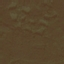
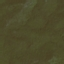
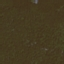
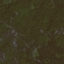
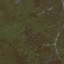
...
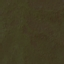
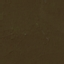
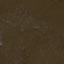
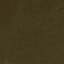
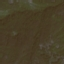

In [ ]:
  ## plots the eurosat Forest class images that are 64x64, here forest has 3000 
  ## images thus max_images is set to 4000
  source_folder = "/content/EuroSAT_Extracted/EuroSAT/Forest"

  def load_images_from_folder(folder):
      images = []
      for filename in os.listdir(folder):
          img = cv2.imread(os.path.join(folder,filename))
          if img is not None:
              images.append(img)
      return images

  images = load_images_from_folder(source_folder)

  ipyplot.plot_images(images, max_images=4000, img_width=64)

In [ ]:
  ## unzips the LandSAT.zip dataset shared in the drive and creates a new drive and stores unzipped images
  ## in that
  source_file = "/content/LandSAT.zip"
  !mkdir "/content/LandSAT_Extracted"
  dest_file = "/content/LandSAT_Extracted"

  import zipfile 

  zip_ref = zipfile.ZipFile(source_file, 'r')
  zip_ref.extractall(dest_file)
  zip_ref.close()

In [ ]:
  import os
  path = "/content/TestDataset/gridimages/imagesOP"
  isExist = os.path.exists(path)
  if not isExist:

    os.makedirs(path)
    print("The new directory is created!")


The new directory is created!


In [ ]:
  ## crops one of the LandSAT images and stores the tiles in imagesOP folder


  def tile(filename, dir_in, dir_out, d):
      name, ext = os.path.splitext(filename)
      img = cv2.imread(os.path.join(dir_in, filename))
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      im_pil = PIL.Image.fromarray(img)
      w,h = im_pil.size
      
      grid = itertools.product(range(0, h-h%d, d), range(0, w-w%d, d))
      for i, j in grid:
          box = (j, i, j+d, i+d)
          out = os.path.join(dir_out, f'{name}_{i}_{j}.PNG')
          im_pil.crop(box).save(out, quality=95)

  tile("city_003_color.TIFF",
      "/content/LandSAT_Extracted/LandSAT/lompoc",
      "/content/TestDataset/gridimages/imagesOP", 
      64)


In [ ]:
  ## displays images from imagesOP folder
  def load_images_from_folder(folder):
      images = []
      labels =[]
      for filename in os.listdir(folder):
          img = cv2.imread(os.path.join(folder,filename))
          if img is not None:
              images.append(img)
              labels.append(filename)
              
      return (images, labels)


  images = load_images_from_folder("/content/TestDataset/gridimages/imagesOP")[0]
  labels = load_images_from_folder("/content/TestDataset/gridimages/imagesOP")[1]

  ipyplot.plot_images(images,labels,max_images=500, img_width=64)

In [ ]:
  ## Visualizations on our EuroSAT dataset

  # import pandas library as pd
  import pandas as pd
  import os, os.path

  APP_FOLDER = '/content/EuroSAT_Extracted/EuroSAT'
  totalFiles = 0
  totalDir = 0 

  # create an Empty DataFrame object
  total_images_df = pd.DataFrame(columns = ['ClassName', 'ImageCount'])
    

  for base, dirs, files in os.walk(APP_FOLDER):
      
      totalFiles = 0
          
      for directories in dirs:
          totalDir += 1
      for Files in files:
          totalFiles += 1
      
      folderName = os.path.basename(base)
      new_row = pd.DataFrame({'ClassName' : folderName, 'ImageCount' : totalFiles}, index=[0])
      total_images_df = pd.concat([new_row,total_images_df.loc[:]]).reset_index(drop=True)

  total_images_df.drop(total_images_df.tail(1).index,inplace=True)
  print(total_images_df)
  print('\n\nTotal Number of directories',totalDir) 


              ClassName ImageCount
0           Residential       3000
1            AnnualCrop       3000
2                 River       2500
3               Highway       2500
4               SeaLake       3000
5         PermanentCrop       2500
6               Pasture       2000
7                Forest       3000
8            Industrial       2500
9  HerbaceousVegetation       3000


Total Number of directories 10


In [ ]:
  # libraries & dataset
  import seaborn as sns
  import matplotlib.pyplot as plt 

  sns.set(style="whitegrid") 
  sns.kdeplot(total_images_df['ImageCount'],shade=True, color="olive")
  plt.legend() 
  plt.show()

<ipython-input-12-cb9e74414ec2>:6: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(total_images_df['ImageCount'],shade=True, color="olive")


In [ ]:
  # Libraries and data
  import matplotlib.pyplot as plt
  import numpy as np
  import pandas as pd
  
  # Draw line chart with dashed line
  plt.plot( 'ClassName', 'ImageCount', data=total_images_df, linestyle='dashed')
  plt.xticks(rotation=45, ha='right')
  # Show graph
  plt.show()

In [ ]:
  import numpy as np
  import pandas as pd
  import matplotlib.pyplot as plt
  
  # Reorder it based on values:
  ordered_df = total_images_df.sort_values(by='ImageCount')
  my_range=range(1,len(total_images_df.index)+1)
  
  # Create a color for class with least image files
  my_color=np.where(total_images_df['ClassName']=='Pasture', '#F9A756', '#6CD9EF')
  my_size=np.where(total_images_df['ClassName']=='Pasture', 70, 30)
  
  # The horizontal plot is made using the hline() function
  plt.hlines(y=my_range, xmin=0, xmax=total_images_df['ImageCount'], color=my_color, alpha=0.4)
  plt.scatter(total_images_df['ImageCount'], my_range, color=my_color, s=my_size, alpha=1)
  
  # Add title and axis names
  plt.yticks(my_range, total_images_df['ClassName']) 
  plt.xlabel('ImageCount')
  plt.ylabel('ClassName')
  plt.title('Image Count vs Class Label')

  # show the graph
  plt.show()

In [ ]:
  import numpy as np
  import seaborn as sns
  import matplotlib.pyplot as plt 

  # initialize the figure
  plt.figure(figsize=(8,8))
  ax = plt.subplot(111, polar=True)
  plt.axis('off')

  upperLimit = 5000
  lowerLimit = 1000
  max = total_images_df['ImageCount'].max()
  slope = (max - lowerLimit) / max
  heights = slope * total_images_df.ImageCount + lowerLimit

  # Compute the width of each bar. In total we have 2*Pi = 360°
  width = 2*np.pi / len(total_images_df.index)

  indexes = list(range(1, len(total_images_df.index)+1))
  angles = [element * width for element in indexes]
  angles

  # Draw bars
  bars = ax.bar(
      x=angles, 
      height=heights, 
      width=width, 
      bottom=lowerLimit,
      linewidth=4, 
      edgecolor="white",
      color='#900C3F'
  )

  # little space between the bar and the label
  labelPadding = 20

  # Add labels
  for bar, angle, height, label in zip(bars,angles, heights, total_images_df["ClassName"]):

      # Labels are rotated. Rotation must be specified in degrees :(
      rotation = np.rad2deg(angle)

      # Flip some labels upside down
      alignment = ""
      if angle >= np.pi/2 and angle < 3*np.pi/2:
          alignment = "right"
          rotation = rotation + 180
      else: 
          alignment = "left"

      # Finally add the labels
      ax.text(
          x=angle, 
          y=lowerLimit + bar.get_height() + labelPadding, 
          s=label, 
          ha=alignment, 
          va='center', 
          rotation=rotation, 
          rotation_mode="anchor") 

In [ ]:
  import matplotlib.pyplot as plt
  import matplotlib.image as mpimg
  import numpy as np
  import PIL


  main_folder = '/content/EuroSAT_Extracted/EuroSAT/'
  directory=os.listdir(main_folder)  
  images = []
  fig, axs = plt.subplots(nrows=2, ncols=5, figsize=(10, 10))

  if '.DS_Store' in directory:
    directory.remove('.DS_Store')

  for num, each in enumerate(directory):
      currentFolder = main_folder + each 
      fullpath = currentFolder+ "/" + os.listdir(currentFolder)[17]
      print(fullpath)
      img = PIL.Image.open(fullpath)
      plt.subplot(2,5,num+1)
      plt.title(each)
      plt.axis('off')
      plt.imshow(img)


/content/EuroSAT_Extracted/EuroSAT/HerbaceousVegetation/HerbaceousVegetation_198.jpg
/content/EuroSAT_Extracted/EuroSAT/Industrial/Industrial_2157.jpg
/content/EuroSAT_Extracted/EuroSAT/Forest/Forest_1343.jpg
/content/EuroSAT_Extracted/EuroSAT/Pasture/Pasture_118.jpg
/content/EuroSAT_Extracted/EuroSAT/PermanentCrop/PermanentCrop_521.jpg
/content/EuroSAT_Extracted/EuroSAT/SeaLake/SeaLake_1612.jpg
/content/EuroSAT_Extracted/EuroSAT/Highway/Highway_642.jpg
/content/EuroSAT_Extracted/EuroSAT/River/River_740.jpg
/content/EuroSAT_Extracted/EuroSAT/AnnualCrop/AnnualCrop_1583.jpg
/content/EuroSAT_Extracted/EuroSAT/Residential/Residential_1166.jpg


In [ ]:
  import matplotlib.pyplot as plt
  from mpl_toolkits import mplot3d
  from PIL import Image

  im = Image.open('/content/EuroSAT_Extracted/EuroSAT/Industrial/Industrial_2047.jpg')
  px = im.load()

  ax = plt.axes(projection = '3d')
  x = []
  y = []
  z = []
  c = []

  for row in range(0,im.height):
      for col in range(0, im.width):
          pix = px[col,row]
          newCol = (pix[0] / 255, pix[1] / 255, pix[2] / 255)

          if(not newCol in c):
              x.append(pix[0])
              y.append(pix[1])
              z.append(pix[2])
              c.append(newCol)

  ax.scatter(x,y,z, c = c)
  plt.title('Scatter plot showing the break down of the colors that are present in an Industrial image.', size=20)
  plt.show()

In [ ]:
# training the neural network model

In [ ]:
##

In [ ]:
  pip install tensorflow tensorflow_addons tensorflow_hub numpy matplotlib seaborn sklearn

In [ ]:
  import seaborn as sns
  import tensorflow as tf
  #  import tensorflow_datasets as tfds
  import tensorflow_hub as hub
  import tensorflow_addons as tfa
  import numpy as np
  import os
  import PIL
  import PIL.Image

In [ ]:
  eurosat_train_ds =  tf.keras.utils.image_dataset_from_directory(
                                                                  directory= '/content/EuroSAT_Extracted/EuroSAT',
                                                                  labels='inferred',
                                                                  seed= 123,
                                                                  validation_split=0.2,
                                                                  image_size=(64, 64),
                                                                  batch_size =50,
                                                                  subset="training") 
  
  eurosat_val_ds = tf.keras.utils.image_dataset_from_directory(
                                                      directory= '/content/EuroSAT_Extracted/EuroSAT',
                                                      validation_split=0.2,
                                                      seed = 123,
                                                      subset="validation",
                                                      batch_size =50,
                                                      image_size=(64, 64))
  
# load training & validation sets, splitting by 80% and 20% respectively

Found 27000 files belonging to 10 classes.
Using 21600 files for training.
Found 27000 files belonging to 10 classes.
Using 5400 files for validation.


In [ ]:
  class_names = eurosat_train_ds.class_names
  print(class_names)

['AnnualCrop', 'Forest', 'HerbaceousVegetation', 'Highway', 'Industrial', 'Pasture', 'PermanentCrop', 'Residential', 'River', 'SeaLake']


In [ ]:
  import matplotlib.pyplot as plt

  plt.figure(figsize=(10, 10))
  for images, labels in eurosat_train_ds.take(1):
    for i in range(10):
      ax = plt.subplot(2,5, i + 1)
      plt.imshow(images[i].numpy().astype("uint8"))
      plt.title(class_names[labels[i]])
      plt.axis("off")

In [ ]:
  for image_batch, labels_batch in eurosat_train_ds:
    print(image_batch.shape) #32 images batch of 64x64 having 3 (rgb) colour channels
    print(labels_batch.shape) #labels of the 32 images in the batch
    break
  
  

(32, 64, 64, 3)
(32,)


In [ ]:
  normalization_layer = tf.keras.layers.Rescaling(1./255)   #making the rgb channel values between [0,1]
  
  normalized_ds = eurosat_train_ds.map(lambda x, y: (normalization_layer(x), y))
  image_batch, labels_batch = next(iter(normalized_ds))
  first_image = image_batch[0]

  # Notice the pixel values are now in `[0,1]`.
  print(np.min(first_image), np.max(first_image))

0.14117648 0.75294125


In [ ]:
  AUTOTUNE = tf.data.AUTOTUNE

  eurosat_train_ds = eurosat_train_ds.cache().prefetch(buffer_size=AUTOTUNE)
  eurosat_val_ds = eurosat_val_ds.cache().prefetch(buffer_size=AUTOTUNE)

In [ ]:
  data_augmentation = keras.Sequential(
    [
      layers.RandomFlip("horizontal",
                        input_shape=(64,
                                    64,
                                    3)),
      layers.RandomRotation(0.1),
      layers.RandomZoom(0.1),
    ]
  )

In [ ]:
  num_classes = 10

  model = Sequential([
  data_augmentation,
  layers.Rescaling(1./255),
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Dropout(0.2),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes, name="outputs")
  ])

In [ ]:
  model.compile(
    optimizer='adam',
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics=['accuracy'])

In [ ]:
  history = model.fit(
    eurosat_train_ds,
    validation_data=eurosat_val_ds,
    epochs=15
  )

Epoch 1/15
675/675 [==============================] - 144s 209ms/step - loss: 1.2283 - accuracy: 0.5490 - val_loss: 1.1529 - val_accuracy: 0.6041
Epoch 2/15
675/675 [==============================] - 135s 200ms/step - loss: 0.8206 - accuracy: 0.7009 - val_loss: 0.9869 - val_accuracy: 0.6887
Epoch 3/15
675/675 [==============================] - 135s 200ms/step - loss: 0.6845 - accuracy: 0.7506 - val_loss: 1.0398 - val_accuracy: 0.6713
Epoch 4/15
675/675 [==============================] - 132s 196ms/step - loss: 0.6155 - accuracy: 0.7782 - val_loss: 0.7051 - val_accuracy: 0.7678
Epoch 5/15
675/675 [==============================] - 137s 203ms/step - loss: 0.5586 - accuracy: 0.7999 - val_loss: 0.5903 - val_accuracy: 0.7935
Epoch 6/15
675/675 [==============================] - 136s 202ms/step - loss: 0.5208 - accuracy: 0.8138 - val_loss: 0.4958 - val_accuracy: 0.8306
Epoch 7/15
675/675 [==============================] - 133s 197ms/step - loss: 0.4894 - accuracy: 0.8232 - val_loss: 0.5150 -

In [ ]:
  from keras.callbacks import History 
  print(history.history.keys())

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


In [ ]:
  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']

  loss = history.history['loss']
  val_loss = history.history['val_loss']

  epochs_range = range(15)

  plt.figure(figsize=(8, 8))
  plt.subplot(1, 2, 1)
  plt.plot(epochs_range, acc, label='Training Accuracy')
  plt.plot(epochs_range, val_acc, label='Validation Accuracy')
  plt.legend(loc='lower right')
  plt.title('Training and Validation Accuracy')

  plt.subplot(1, 2, 2)
  plt.plot(epochs_range, loss, label='Training Loss')
  plt.plot(epochs_range, val_loss, label='Validation Loss')
  plt.legend(loc='upper right')
  plt.title('Training and Validation Loss')
  plt.show()

In [ ]:
  city_image = "/content/TestDataset/gridimages/imagesOP/city_003_color_768_704.PNG"
  # city_image_path = tf.keras.utils.get_file('city image', origin=city_image)

  img = tf.keras.utils.load_img(
      city_image, target_size=(64, 64)
  )
  img_array = tf.keras.utils.img_to_array(img)
  img_array = tf.expand_dims(img_array, 0) # Create a batch

  predictions = model.predict(img_array)
  score = tf.nn.softmax(predictions[0])

  print(
      "This image most likely belongs to {} with a {:.2f} percent confidence."
      .format(class_names[np.argmax(score)], 100 * np.max(score))
  )

1/1 [==============================] - 0s 207ms/step
This image most likely belongs to HerbaceousVegetation with a 56.27 percent confidence.
